# Project 4: Regression
**ECE 219**: Large-Scale Data Mining: Models and Algorithms [Winter 2021]

Prof. Vwani Roychowdhury

UCLA, Department of ECE

**Due**: 2021.03.19 11:59PM PT

In [1]:
# !pip install pandas-profiling[notebook]

In [2]:
from pandas_profiling import ProfileReport
from IPython.display import display
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

In [3]:
BIKE_SHARING_DATA = "data/bike_sharing/day.csv"
SUICIDE_DATA = "data/suicides/master.csv"
VIDEO_TRANSCODING_DATA = "data/video_transcoding/transcoding_mesurment.tsv"

In [4]:
Ys_bik = ['casual', 'registered', 'cnt']
df_bik = pd.read_csv(BIKE_SHARING_DATA)

In [5]:
Xs_sui = [
    'country', 
    'year', 
    'sex', 
    'age', 
    'population', 
    ' gdp_for_year ($) ',
    'gdp_per_capita ($)',
    'generation'
]
Ys_sui = ['suicides_no', 'suicides/100k pop']
df_sui = pd.read_csv(SUICIDE_DATA, usecols=Xs_sui+Ys_sui)
df_sui.reset_index(drop=True, inplace=True)
df_sui.columns = [col.strip() for col in df_sui.columns]
Xs_sui = [col.strip() for col in Xs_sui]
df_sui['gdp_for_year ($)'] = df_sui['gdp_for_year ($)'].map(lambda x: int(x.replace(',', "")))

In [6]:
Ys_vid = ['utime']
df_vid = pd.read_csv(VIDEO_TRANSCODING_DATA, sep='\t')

In [28]:
dfs = [df_bik, df_sui, df_vid]
Ys = [Ys_bik, Ys_sui, Ys_vid]
datasets = ['Bike Sharing', 'Suicide', 'Video Transcoding']
colors = ['blue', 'red', 'green']

# Q1

Plot a heatmap of Pearson correlation matrix of dataset columns. Report which features have the highest absolute correlation with the target variable and what
that implies.

In [60]:
for d, df, Y in zip(datasets, dfs, Ys):
    print(d)
    display(df.corr(method='pearson').loc[Y].T)

Bike Sharing


,casual,registered,cnt
instant,0.275255,0.659623,0.628830
season,0.210399,0.411623,0.406100
yr,0.248546,0.594248,0.566710
mnth,0.123006,0.293488,0.279977
holiday,0.054274,-0.108745,-0.068348
weekday,0.059923,0.057367,0.067443
workingday,-0.518044,0.303907,0.061156
weathersit,-0.247353,-0.260388,-0.297391
temp,0.543285,0.540012,0.627494
atemp,0.543864,0.544192,0.631066


Suicide


,suicides_no,suicides/100k pop
year,-0.004546,-0.039037
suicides_no,1.000000,0.306604
population,0.616162,0.008285
suicides/100k pop,0.306604,1.000000
gdp_for_year ($),0.430096,0.025240
gdp_per_capita ($),0.061330,0.001785


Video Transcoding


,utime
duration,0.005533
width,0.129861
height,0.128479
bitrate,0.155200
framerate,0.079336
i,0.018489
p,0.033201
b,0.005140
frames,0.033115
i_size,0.064711


In [61]:
ProfileReport(df_bik, explorative=True).to_notebook_iframe()

In [62]:
ProfileReport(df_sui, explorative=True).to_notebook_iframe()

In [63]:
ProfileReport(df_vid, explorative=True).to_notebook_iframe()

In [64]:
for d, df, Y in zip(datasets, dfs, Ys):
    p = ProfileReport(
        df, 
        title="Pandas Profiling Report for " + d + " Dataset", 
        explorative=True
    )
    # p.to_notebook_iframe()
    p.to_file("reports/" + d + " Report.html")

# Q2

Plot the histogram of numerical features. What preprocessing can be done if the distribution of a feature has high skewness?

**ANSWER**

The following techniques can be used to address feature skew:

- log transform
- boxcox transform
- root transform (square, cube, etc.)
- power transform (square, cube, etc.)

In [27]:
def get_numeric_cols(df):
    return df.select_dtypes(include=[np.number]).columns

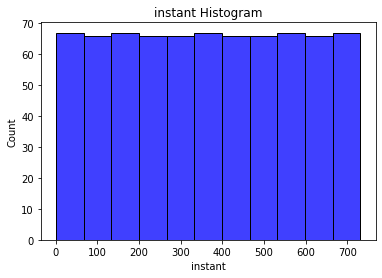

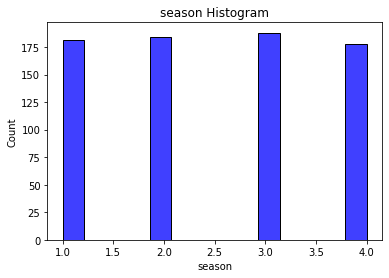

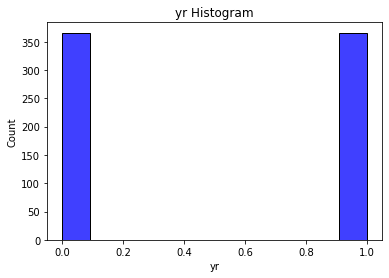

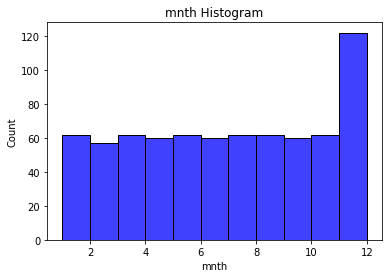

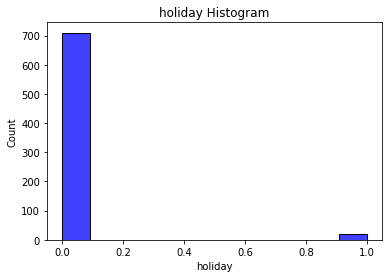

...

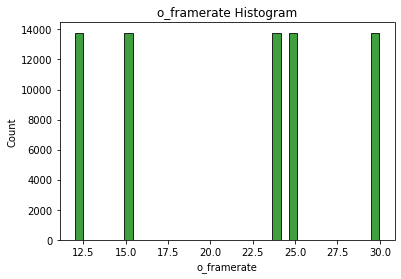

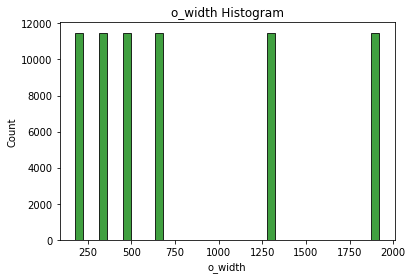

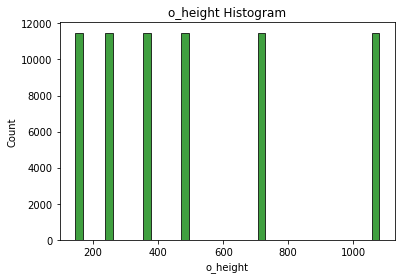

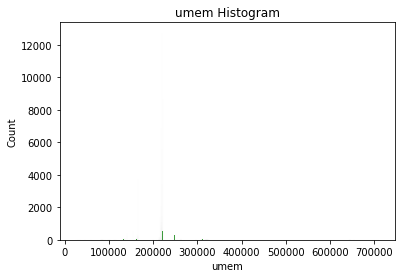

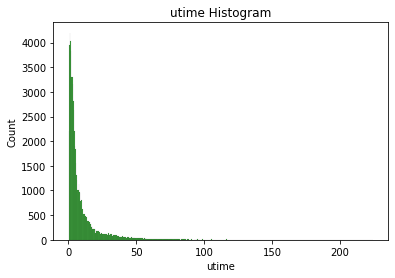

In [36]:
for d, df, Y, c in zip(datasets, dfs, Ys, colors):
    for col in get_numeric_cols(df):
        g = sns.histplot(df[col], color=c)
        g.set_title(col + " Histogram")
        plt.show()

# Q3

